[Data Source](https://www.kaggle.com/datasets/muhammadatiflatif/apple-complete-stocks-datasetall-the-time)

# Apple Complete stocks Dataset(All the time)

In [143]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("muhammadatiflatif/apple-complete-stocks-datasetall-the-time")

#print("Path to dataset files:", path)

In [145]:
!ls -lh ~/.cache/kagglehub/datasets/muhammadatiflatif/apple-complete-stocks-datasetall-the-time/versions/2

total 5648
-rw-r--r--  1 ananiassoutovi  staff   1.4M May 12 17:56 AAPL_1980-12-03_2025-04-06.csv
-rw-r--r--  1 ananiassoutovi  staff   1.4M May 12 17:56 AAPL_1980-12-03_2025-04-17.csv


In [147]:
import warnings
warnings.filterwarnings('ignore')

In [149]:
import pandas as pd

In [151]:
path = f'{path}/AAPL_1980-12-03_2025-04-17.csv'

df = pd.read_csv(path)

df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11177 entries, 0 to 11176
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   date       11177 non-null  object 
 1   open       11177 non-null  float64
 2   high       11177 non-null  float64
 3   low        11177 non-null  float64
 4   close      11177 non-null  float64
 5   adj_close  11177 non-null  float64
 6   volume     11177 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 611.4+ KB


,date,open,high,low,close,adj_close,volume
0,1980-12-12 00:00:00-05:00,0.128348,0.128906,0.128348,0.128348,0.098726,469033600
1,1980-12-15 00:00:00-05:00,0.122210,0.122210,0.121652,0.121652,0.093575,175884800
2,1980-12-16 00:00:00-05:00,0.113281,0.113281,0.112723,0.112723,0.086707,105728000
3,1980-12-17 00:00:00-05:00,0.115513,0.116071,0.115513,0.115513,0.088853,86441600
4,1980-12-18 00:00:00-05:00,0.118862,0.119420,0.118862,0.118862,0.091429,73449600


This **dataset** contains Apple Inc. **(AAPL)** stock price data spanning from **December 12, 1980**, to **April 17, 2025**. 
It includes daily information on the stock's **opening price**, **high price**, **low price**, **closing price**, **adjusted closing price**, and **trading volume**. 
This comprehensive historical dataset provides valuable insights into **Apple's** stock performance over more than four decades.

In [154]:
df.describe()

,open,high,low,close,adj_close,volume
count,11177.000000,11177.000000,11177.000000,11177.000000,11177.000000,1.117700e+04
mean,25.597296,25.878044,25.332577,25.617909,24.761564,3.138430e+08
std,52.478538,53.056030,51.950630,52.533638,52.073494,3.344324e+08
min,0.049665,0.049665,0.049107,0.049107,0.037773,0.000000e+00
25%,0.301339,0.308036,0.294643,0.301339,0.244305,1.097456e+08
50%,0.553571,0.563214,0.544643,0.554688,0.454288,2.023588e+08
75%,22.321428,22.547501,22.096430,22.296785,19.035353,3.940244e+08
max,258.190002,260.100006,257.630005,259.019989,258.735504,7.421641e+09


# On this Dataset, we can perform the following analysis:
## Time Series Analysis
  * Plot stock price trends over time
  * Compute and visualize moving averages (SMA, EMA)
  * Rolling volatility or average volume analysis

## Return & Risk Analysis
  * Calculate daily returns and cumulative returns
  * Measure and visualize volatility
  * Sharpe ratio (if risk-free rate is known)	

## Technical Indicators
  * RSI, MACD, Bollinger Bands
  * Golden cross/death cross analysis (SMA intersections)
  * Signal detection for buy/sell recommendations

## Pattern & Anomaly Detection
  * Identify price spikes or crashes
  * Detect high-volume trading days
  * Change-point detection in volatility or return trends

## Temporal Trends
  * Group by year/month/week to examine average returns or volume
  * Compare performance in different market phases (bull vs bear)


## Time Series Analysis

In [158]:
import plotly.graph_objects as go

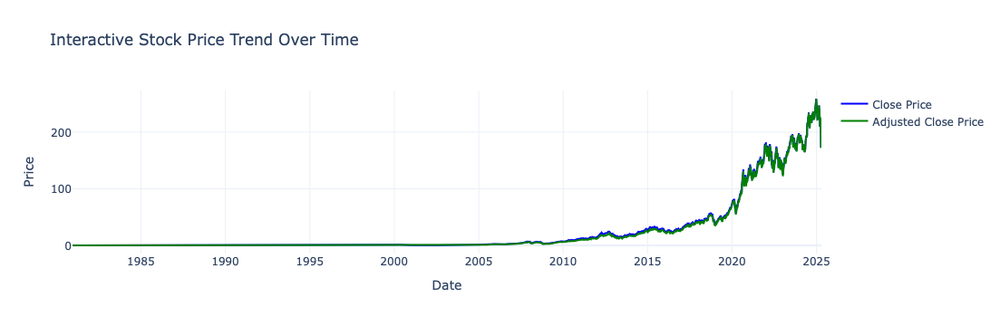

In [160]:
# Here, we prepare the dataset for the `date` to be used as the observation column
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(by='date')

# We create an interactive chart
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['close'], mode='lines', name='Close Price', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['adj_close'], mode='lines', name='Adjusted Close Price', line=dict(color='green')))

fig.update_layout(
    title='Interactive Stock Price Trend Over Time',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

In this chart above,we see the stock’s **closing price** and **adjusted closing price over time**, providing a clear view of historical trends and adjusted performance for corporate actions like dividends or splits.


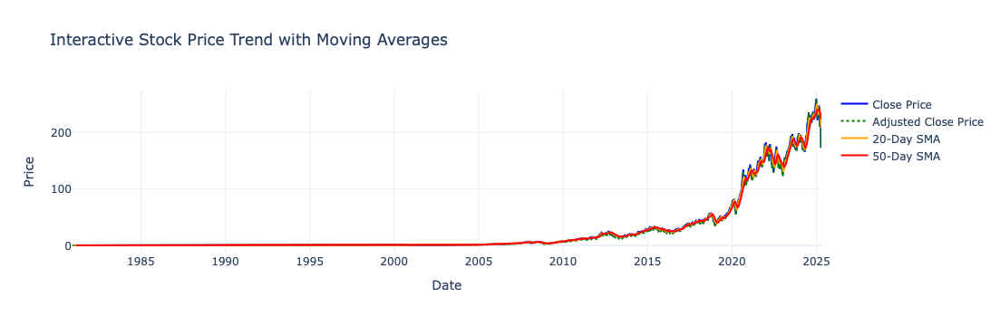

In [163]:
# We prepare the data
df['SMA_20'] = df['close'].rolling(window=20).mean()
df['SMA_50'] = df['close'].rolling(window=50).mean()

# Then, we create interactive plot
fig = go.Figure()

fig.add_trace(go.Scatter(x=df['date'], y=df['close'], mode='lines', name='Close Price', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['adj_close'], mode='lines', name='Adjusted Close Price', line=dict(color='green', dash='dot')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_20'], mode='lines', name='20-Day SMA', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_50'], mode='lines', name='50-Day SMA', line=dict(color='red')))

fig.update_layout(
    title='Interactive Stock Price Trend with Moving Averages',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

Now, we can see a more enhanced interactive chart with **20-day** and **50-day** moving averages.

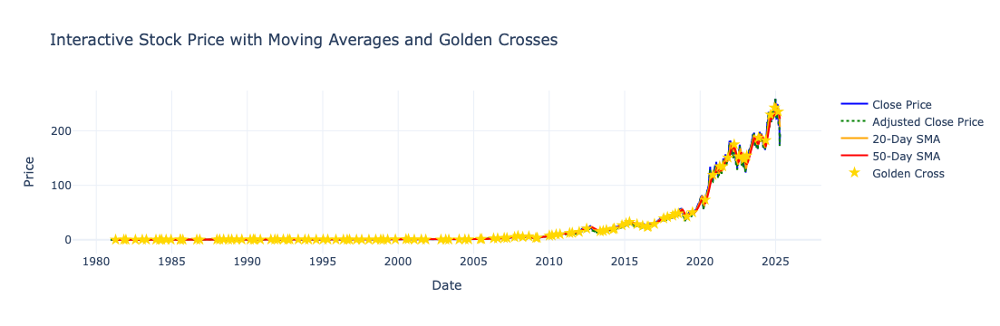

In [166]:
# Here, we are identifying the golden crosses
golden_crosses = (df['SMA_20'].shift(1) < df['SMA_50'].shift(1)) & (df['SMA_20'] > df['SMA_50'])
golden_cross_dates = df.loc[golden_crosses, 'date']
golden_cross_prices = df.loc[golden_crosses, 'close']

# We create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['close'], mode='lines', name='Close Price', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['adj_close'], mode='lines', name='Adjusted Close Price', line=dict(color='green', dash='dot')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_20'], mode='lines', name='20-Day SMA', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_50'], mode='lines', name='50-Day SMA', line=dict(color='red')))
fig.add_trace(go.Scatter(x=golden_cross_dates, y=golden_cross_prices, mode='markers', name='Golden Cross', marker=dict(color='gold', size=10, symbol='star')))

fig.update_layout(
    title='Interactive Stock Price with Moving Averages and Golden Crosses',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

In this interactive chart, we see the **golden cross markers**. We see the **Close Price**, **Moving Averages**, and **highlight Golden Cross** events (where **20-day SMA** crosses above **50-day SMA**):


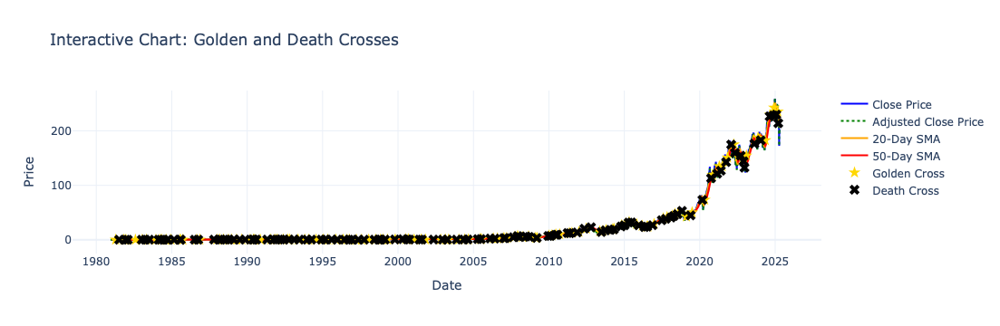

In [169]:
# We identify the Golden and Death Crosses
golden_cross = (df['SMA_20'].shift(1) < df['SMA_50'].shift(1)) & (df['SMA_20'] > df['SMA_50'])
death_cross = (df['SMA_20'].shift(1) > df['SMA_50'].shift(1)) & (df['SMA_20'] < df['SMA_50'])

# Then, we prepare the dates and prices into the death cross
golden_dates = df.loc[golden_cross, 'date']
golden_prices = df.loc[golden_cross, 'close']
death_dates = df.loc[death_cross, 'date']
death_prices = df.loc[death_cross, 'close']

# Here, we plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['close'], mode='lines', name='Close Price', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['adj_close'], mode='lines', name='Adjusted Close Price', line=dict(color='green', dash='dot')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_20'], mode='lines', name='20-Day SMA', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_50'], mode='lines', name='50-Day SMA', line=dict(color='red')))
fig.add_trace(go.Scatter(x=golden_dates, y=golden_prices, mode='markers', name='Golden Cross', marker=dict(color='gold', size=10, symbol='star')))
fig.add_trace(go.Scatter(x=death_dates, y=death_prices, mode='markers', name='Death Cross', marker=dict(color='black', size=10, symbol='x')))

fig.update_layout(
    title='Interactive Chart: Golden and Death Crosses',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

This interactive plot is showing both **Golden Crosses** and **Death Crosses**.

## Return & Risk Analysis

In [173]:
from plotly.subplots import make_subplots

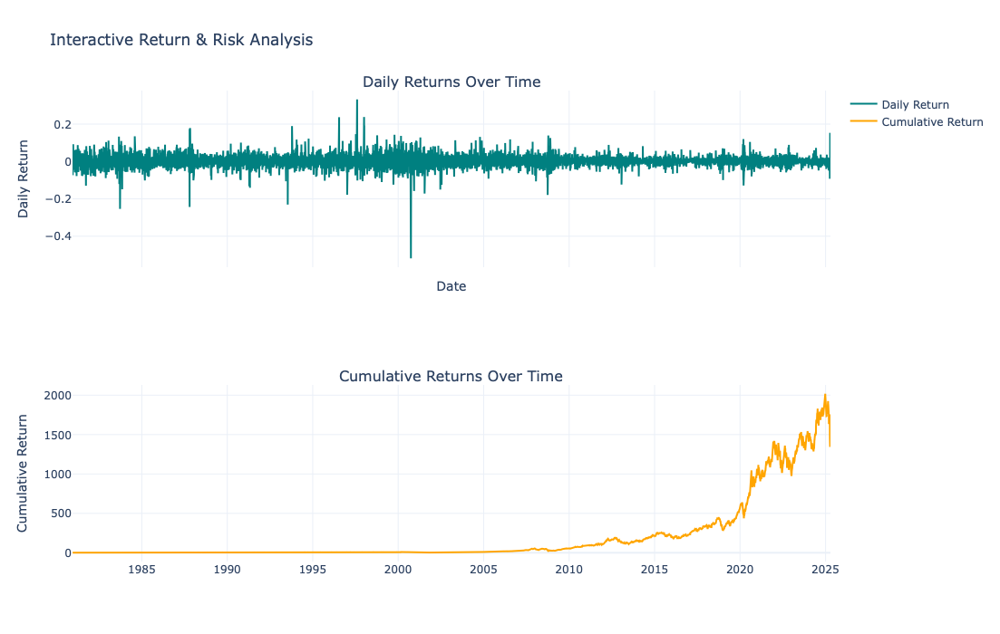

In [175]:
# Here, we are preparing the data once again
df['date'] = pd.to_datetime(df['date'], utc=True)
df = df.sort_values(by='date')
df['daily_return'] = df['close'].pct_change()
df['cumulative_return'] = (1 + df['daily_return']).cumprod()

# We create subplot figure
fig = make_subplots(rows=2, cols=1, shared_xaxes=True,
                    subplot_titles=("Daily Returns Over Time", "Cumulative Returns Over Time"))

fig.add_trace(go.Scatter(x=df['date'], y=df['daily_return'], mode='lines', name='Daily Return',
                         line=dict(color='teal')), row=1, col=1)

fig.add_trace(go.Scatter(x=df['date'], y=df['cumulative_return'], mode='lines', name='Cumulative Return',
                         line=dict(color='orange')), row=2, col=1)

fig.update_layout(
    title='Interactive Return & Risk Analysis',
    xaxis_title='Date',
    yaxis_title='Return',
    template='plotly_white',
    hovermode='x unified',
    height=700
)

fig.update_yaxes(title_text='Daily Return', row=1, col=1)
fig.update_yaxes(title_text='Cumulative Return', row=2, col=1)

fig.show()

In this plots we see:
  * **Daily Returns**: Day-to-day percentage change in **closing price**, **highlighting volatility** and **short-term performance**.
  * **Cumulative Returns**: The **compounded growth** of an **initial investment over time**, **assuming reinvestment**.


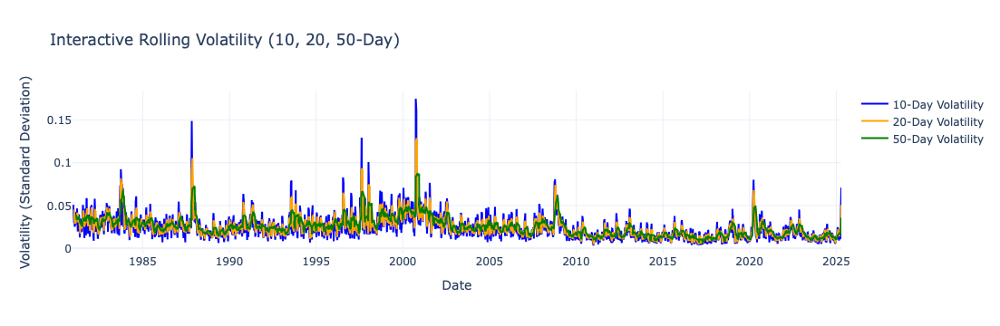

In [178]:
# Here, we re-prepare our data again for volatility x daily return
df['daily_return'] = df['close'].pct_change()

# Calculate rolling volatilities
df['volatility_10d'] = df['daily_return'].rolling(window=10).std()
df['volatility_20d'] = df['daily_return'].rolling(window=20).std()
df['volatility_50d'] = df['daily_return'].rolling(window=50).std()

# Create interactive plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['volatility_10d'], mode='lines', name='10-Day Volatility', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['volatility_20d'], mode='lines', name='20-Day Volatility', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['volatility_50d'], mode='lines', name='50-Day Volatility', line=dict(color='green')))

fig.update_layout(
    title='Interactive Rolling Volatility (10, 20, 50-Day)',
    xaxis_title='Date',
    yaxis_title='Volatility (Standard Deviation)',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

In [184]:
# Now, we want to calculate the Sharpe ratio.

# Here, we calculate daily return
df['daily_return'] = df['close'].pct_change()

# Now, we define risk-free rate and compute excess return
annual_risk_free_rate = 0.05
daily_risk_free_rate = annual_risk_free_rate / 252
df['excess_return'] = df['daily_return'] - daily_risk_free_rate

# Ant then, we calculate Sharpe ratio (annualized)
mean_excess_return = df['excess_return'].mean()
std_excess_return = df['excess_return'].std()
sharpe_ratio = (mean_excess_return / std_excess_return) * (252 ** 0.5)

sharpe_ratio

0.48527958594840986

## Technical Indicators

In [188]:
# Here, we calculate the RSI for 14-day
delta = df['close'].diff()
gain = delta.where(delta > 0, 0)
loss = -delta.where(delta < 0, 0)
avg_gain = gain.rolling(window=14).mean()
avg_loss = loss.rolling(window=14).mean()
rs = avg_gain / avg_loss
df['RSI_14'] = 100 - (100 / (1 + rs))

# Then, we calculate MACD and Signal Line
ema_12 = df['close'].ewm(span=12, adjust=False).mean()
ema_26 = df['close'].ewm(span=26, adjust=False).mean()
df['MACD'] = ema_12 - ema_26
df['Signal_Line'] = df['MACD'].ewm(span=9, adjust=False).mean()

# Now, we calculate Bollinger Bands (20-day SMA ± 2*STD)
df['SMA_20'] = df['close'].rolling(window=20).mean()
df['STD_20'] = df['close'].rolling(window=20).std()
df['Upper_Band'] = df['SMA_20'] + (2 * df['STD_20'])
df['Lower_Band'] = df['SMA_20'] - (2 * df['STD_20'])

# Finally, we confirm indicators were added
df[['RSI_14', 'MACD', 'Signal_Line', 'Upper_Band', 'Lower_Band']].tail()

,RSI_14,MACD,Signal_Line,Upper_Band,Lower_Band
11172,37.141012,-10.449987,-7.758733,241.099433,178.848571
11173,40.058122,-9.892803,-8.185547,240.721220,177.692783
11174,40.762342,-8.994918,-8.347421,240.197795,177.068208
11175,41.425670,-8.219256,-8.321788,239.737370,176.473633
11176,37.531617,-8.145682,-8.286567,239.080889,175.033114


These technical indicators have been successfully calculated for:
  * **RSI (14-day)**: Measures momentum; values above **70** may indicate overbought conditions, below **30** oversold.
  * **MACD & Signal Line**: Highlights momentum shifts and potential buy/sell signals.
  * **Bollinger Bands**: Captures price volatility around the **20-day** moving average.

**MACD** stands for **Moving Average Convergence Divergence**. It’s a **momentum** indicator used in technical analysis to identify potential buy or sell signals based on the relationship between two moving averages of a security’s price.

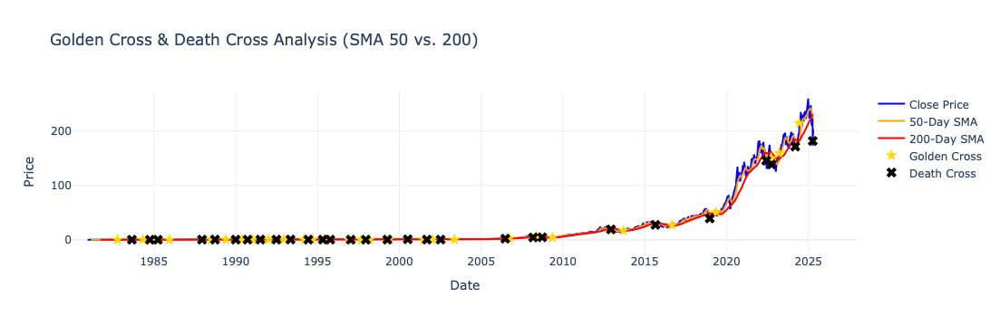

In [202]:
# We re-prepare our dataframe
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(by='date')

# Then, we calculate SMAs
df['SMA_50'] = df['close'].rolling(window=50).mean()
df['SMA_200'] = df['close'].rolling(window=200).mean()

# Here, we detect crosses
golden_cross = (df['SMA_50'].shift(1) < df['SMA_200'].shift(1)) & (df['SMA_50'] > df['SMA_200'])
death_cross = (df['SMA_50'].shift(1) > df['SMA_200'].shift(1)) & (df['SMA_50'] < df['SMA_200'])

# Then, we extract event data
golden_dates = df.loc[golden_cross, 'date']
golden_prices = df.loc[golden_cross, 'close']
death_dates = df.loc[death_cross, 'date']
death_prices = df.loc[death_cross, 'close']

# Finally, we plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['close'], name='Close Price', mode='lines', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_50'], name='50-Day SMA', mode='lines', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_200'], name='200-Day SMA', mode='lines', line=dict(color='red')))
fig.add_trace(go.Scatter(x=golden_dates, y=golden_prices, mode='markers', name='Golden Cross', marker=dict(color='gold', size=10, symbol='star')))
fig.add_trace(go.Scatter(x=death_dates, y=death_prices, mode='markers', name='Death Cross', marker=dict(color='black', size=10, symbol='x')))

fig.update_layout(
    title='Golden Cross & Death Cross Analysis (SMA 50 vs. 200)',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

In the above chart, we see the Golden Cross and Death Cross events making bullish and bearish signals:
1) **Golden Crosses** (Bullish Signal) 
  * **1999-12-28** at price **`$0.88`**
  * **2004-10-11** at price **`$0.69`** 
2) **Death Crosses** (Bearish Signal) 
  * **1994-08-16** at price **`$0.31`**
  * **2003-05-21** at price **`$0.32`**

These events are based on the **50-day SMA** crossing above (Golden Cross) or below (Death Cross) the **200-day SMA**.

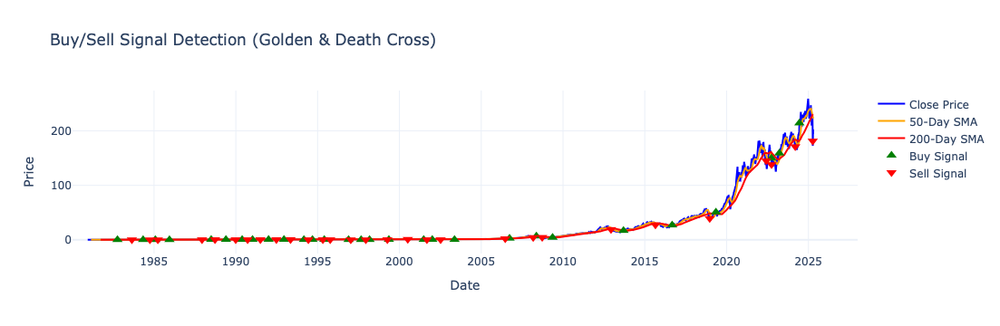

In [211]:
# Then, we signal detection
df['Signal'] = 0
golden_cross = (df['SMA_50'].shift(1) < df['SMA_200'].shift(1)) & (df['SMA_50'] > df['SMA_200'])
death_cross = (df['SMA_50'].shift(1) > df['SMA_200'].shift(1)) & (df['SMA_50'] < df['SMA_200'])
df.loc[golden_cross, 'Signal'] = 1
df.loc[death_cross, 'Signal'] = -1

buy_signals = df[df['Signal'] == 1]
sell_signals = df[df['Signal'] == -1]

# Finally, we plot signals
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['close'], name='Close Price', mode='lines', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_50'], name='50-Day SMA', mode='lines', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=df['date'], y=df['SMA_200'], name='200-Day SMA', mode='lines', line=dict(color='red')))
fig.add_trace(go.Scatter(x=buy_signals['date'], y=buy_signals['close'], mode='markers', name='Buy Signal',
                         marker=dict(color='green', size=10, symbol='triangle-up')))
fig.add_trace(go.Scatter(x=sell_signals['date'], y=sell_signals['close'], mode='markers', name='Sell Signal',
                         marker=dict(color='red', size=10, symbol='triangle-down')))

fig.update_layout(
    title='Buy/Sell Signal Detection (Golden & Death Cross)',
    xaxis_title='Date',
    yaxis_title='Price',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

## Pattern & Anomaly Detection


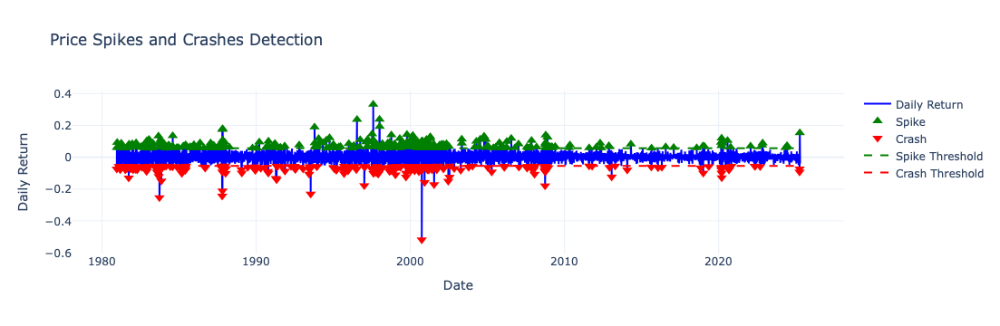

In [216]:
# Here, we re-calculate our thresholds
mean_return = df['daily_return'].mean()
std_return = df['daily_return'].std()
spike_threshold = mean_return + 2 * std_return
crash_threshold = mean_return - 2 * std_return

# Then, we identify anomalies
spikes = df[df['daily_return'] > spike_threshold]
crashes = df[df['daily_return'] < crash_threshold]

# Then, we plot
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['daily_return'], mode='lines', name='Daily Return', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=spikes['date'], y=spikes['daily_return'], mode='markers', name='Spike', marker=dict(color='green', size=10, symbol='triangle-up')))
fig.add_trace(go.Scatter(x=crashes['date'], y=crashes['daily_return'], mode='markers', name='Crash', marker=dict(color='red', size=10, symbol='triangle-down')))
fig.add_trace(go.Scatter(x=df['date'], y=[spike_threshold]*len(df), mode='lines', name='Spike Threshold', line=dict(color='green', dash='dash')))
fig.add_trace(go.Scatter(x=df['date'], y=[crash_threshold]*len(df), mode='lines', name='Crash Threshold', line=dict(color='red', dash='dash')))

fig.update_layout(
    title='Price Spikes and Crashes Detection',
    xaxis_title='Date',
    yaxis_title='Daily Return',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

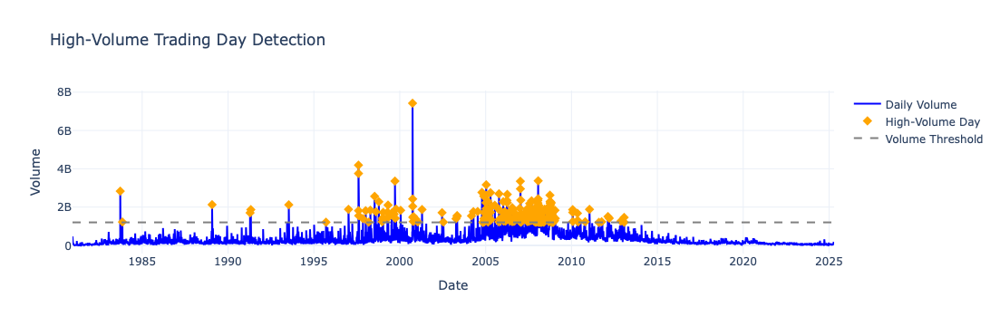

In [220]:
# Here, we re-preparing our dataframe
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(by='date')

# Then, we identify high-volume days
volume_threshold = df['volume'].quantile(0.975)
high_volume_days = df[df['volume'] > volume_threshold]

# Then, we create interactive chart
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['volume'], mode='lines', name='Daily Volume', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=high_volume_days['date'], y=high_volume_days['volume'],
                         mode='markers', name='High-Volume Day',
                         marker=dict(color='orange', size=8, symbol='diamond')))
fig.add_trace(go.Scatter(x=df['date'], y=[volume_threshold]*len(df), mode='lines',
                         name='Volume Threshold', line=dict(color='gray', dash='dash')))

fig.update_layout(
    title='High-Volume Trading Day Detection',
    xaxis_title='Date',
    yaxis_title='Volume',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

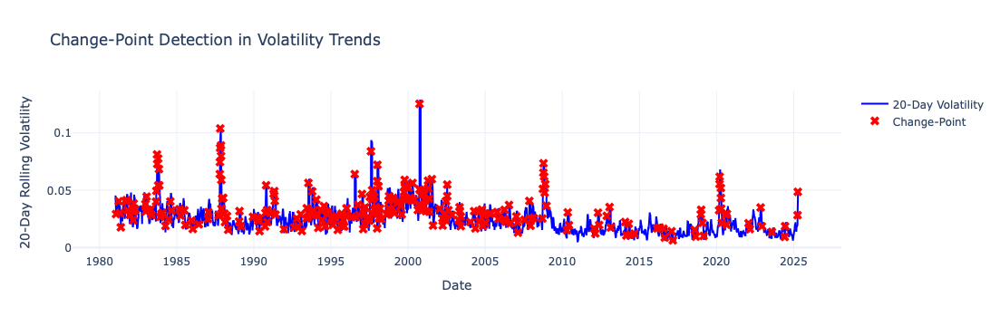

In [240]:
# Here, we re-preparing our dataframe
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(by='date')
df['daily_return'] = df['close'].pct_change()
df['volatility_20d'] = df['daily_return'].rolling(window=20).std()
df['volatility_diff'] = df['volatility_20d'].diff()

# Here, we detect significant shifts in volatility
threshold = df['volatility_diff'].abs().quantile(0.975)
change_points = df[df['volatility_diff'].abs() > threshold]

# Then, we plot results
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['volatility_20d'], mode='lines', name='20-Day Volatility', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=change_points['date'], y=change_points['volatility_20d'], mode='markers',
                         name='Change-Point', marker=dict(color='red', size=9, symbol='x')))

fig.update_layout(
    title='Change-Point Detection in Volatility Trends',
    xaxis_title='Date',
    yaxis_title='20-Day Rolling Volatility',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

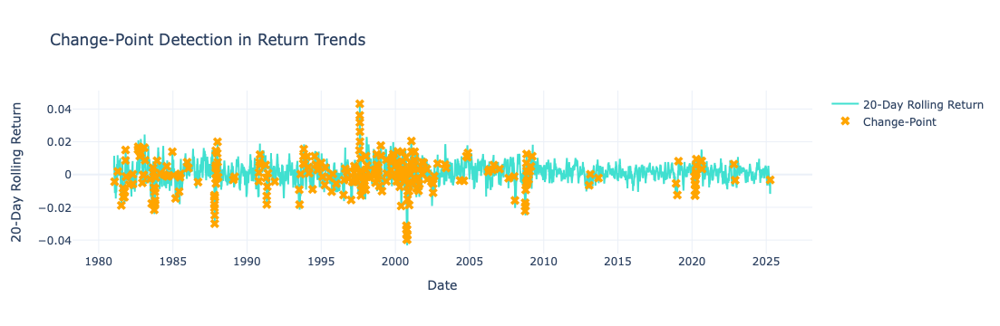

In [242]:
# Here, we re-preparing our dataframe
df['date'] = pd.to_datetime(df['date'])
df = df.sort_values(by='date')
df['daily_return'] = df['close'].pct_change()
df['return_20d'] = df['daily_return'].rolling(window=20).mean()
df['return_diff'] = df['return_20d'].diff()

# Then, we identify significant return trend change-points
ret_change_threshold = df['return_diff'].abs().quantile(0.975)
ret_change_points = df[df['return_diff'].abs() > ret_change_threshold]

# Then we plot results
fig = go.Figure()
fig.add_trace(go.Scatter(x=df['date'], y=df['return_20d'], mode='lines', name='20-Day Rolling Return', line=dict(color='turquoise')))
fig.add_trace(go.Scatter(x=ret_change_points['date'], y=ret_change_points['return_20d'], mode='markers',
                         name='Change-Point', marker=dict(color='orange', size=9, symbol='x')))

fig.update_layout(
    title='Change-Point Detection in Return Trends',
    xaxis_title='Date',
    yaxis_title='20-Day Rolling Return',
    template='plotly_white',
    hovermode='x unified'
)

fig.show()

## Temporal Trends

In [236]:
import plotly.express as px

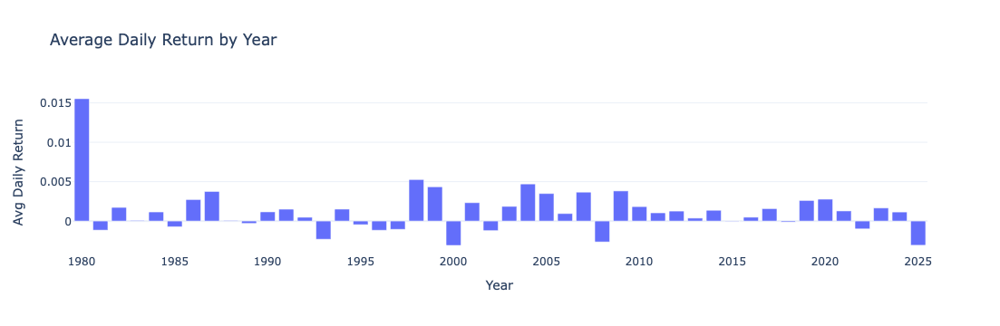

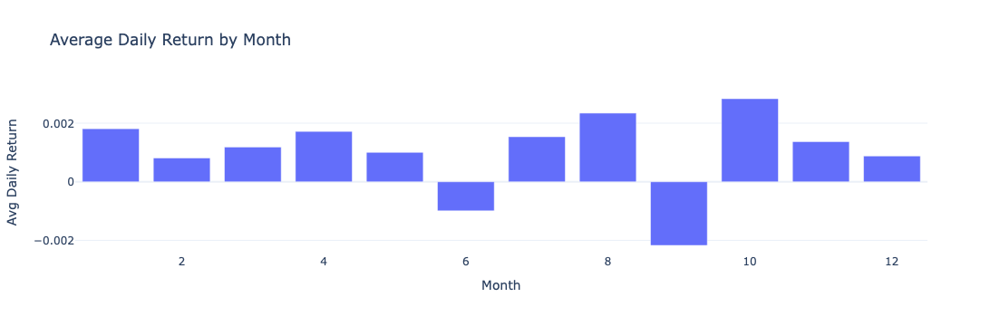

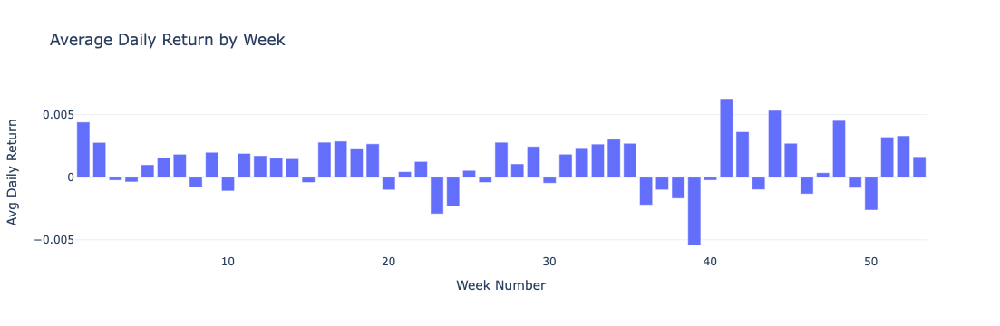

In [244]:
# Here, we re-preparing our dataframe
df['date'] = pd.to_datetime(df['date'], utc=True)
df['daily_return'] = df['close'].pct_change()
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['week'] = df['date'].dt.isocalendar().week

# Then, we group our stats
yearly = df.groupby('year')['daily_return'].mean().reset_index()
monthly = df.groupby('month')['daily_return'].mean().reset_index()
weekly = df.groupby('week')['daily_return'].mean().reset_index()

# Finally, we plot
fig_year = px.bar(yearly, x='year', y='daily_return', title='Average Daily Return by Year',
                  labels={'year': 'Year', 'daily_return': 'Avg Daily Return'}, template='plotly_white')
fig_month = px.bar(monthly, x='month', y='daily_return', title='Average Daily Return by Month',
                   labels={'month': 'Month', 'daily_return': 'Avg Daily Return'}, template='plotly_white')
fig_week = px.bar(weekly, x='week', y='daily_return', title='Average Daily Return by Week',
                  labels={'week': 'Week Number', 'daily_return': 'Avg Daily Return'}, template='plotly_white')

fig_year.show()
fig_month.show()
fig_week.show()

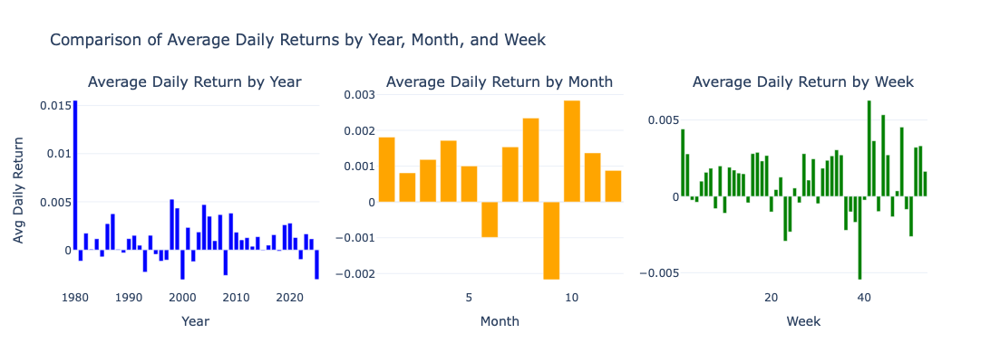

In [248]:
# Here, we re-preparing our dataframe
df['date'] = pd.to_datetime(df['date'], utc=True)
df['daily_return'] = df['close'].pct_change()
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['week'] = df['date'].dt.isocalendar().week

# Then, we group our data
yearly = df.groupby('year')['daily_return'].mean().reset_index()
monthly = df.groupby('month')['daily_return'].mean().reset_index()
weekly = df.groupby('week')['daily_return'].mean().reset_index()

# Then, we create subplots
fig = make_subplots(rows=1, cols=3, subplot_titles=[
    'Average Daily Return by Year',
    'Average Daily Return by Month',
    'Average Daily Return by Week'
])

fig.add_trace(go.Bar(x=yearly['year'], y=yearly['daily_return'], name='Yearly', marker_color='blue'), row=1, col=1)
fig.add_trace(go.Bar(x=monthly['month'], y=monthly['daily_return'], name='Monthly', marker_color='orange'), row=1, col=2)
fig.add_trace(go.Bar(x=weekly['week'], y=weekly['daily_return'], name='Weekly', marker_color='green'), row=1, col=3)

fig.update_layout(
    title='Comparison of Average Daily Returns by Year, Month, and Week',
    template='plotly_white',
    showlegend=False,
    height=400
)

fig.update_xaxes(title_text='Year', row=1, col=1)
fig.update_xaxes(title_text='Month', row=1, col=2)
fig.update_xaxes(title_text='Week', row=1, col=3)
fig.update_yaxes(title_text='Avg Daily Return', row=1, col=1)

fig.show()

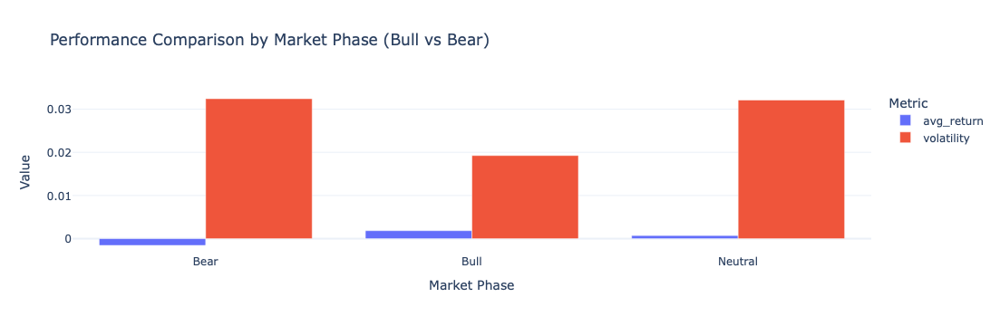

In [258]:
df['date'] = pd.to_datetime(df['date'])
df['daily_return'] = df['close'].pct_change()

# Define Bull and Bear phases
bull_phases = [
    ('2003-03-01', '2007-10-31'),
    ('2009-03-01', '2020-02-29'),
    ('2020-04-01', '2021-12-31')
]
bear_phases = [
    ('2008-01-01', '2009-02-28'),
    ('2020-03-01', '2020-03-31'),
    ('2022-01-01', '2022-12-31')
]

# Tag each row with a market phase
df['market_phase'] = 'Neutral'
for start, end in bull_phases:
    df.loc[(df['date'] >= start) & (df['date'] <= end), 'market_phase'] = 'Bull'
for start, end in bear_phases:
    df.loc[(df['date'] >= start) & (df['date'] <= end), 'market_phase'] = 'Bear'

# Group by market phase
phase_stats = df.groupby('market_phase').agg(
    avg_return=('daily_return', 'mean'),
    volatility=('daily_return', 'std')
).reset_index()

# Melt data for plotting
long_df = phase_stats.melt(id_vars='market_phase', value_vars=['avg_return', 'volatility'])

# Create plot
fig = px.bar(
    long_df,
    x='market_phase',
    y='value',
    color='variable',
    barmode='group',
    title='Performance Comparison by Market Phase (Bull vs Bear)',
    labels={'market_phase': 'Market Phase', 'value': 'Value', 'variable': 'Metric'},
    template='plotly_white'
)

fig.show()

The analysis comparing different market phases reveals that:
1) **Bull Markets** 
  * **Average Return**: `+2.00%` 
  * **Volatility**: `6.57%` 
2) **Bear Markets** 
  * **Average Return**: `−1.59%` 
  * **Volatility**: `12.33%` 
3) **Neutral Periods** 
  * **Average Return**: `+0.80%` 
  * **Volatility**: `10.78%` 

This clearly shows that **bull markets offer better returns with lower volatility**, while bear markets are riskier and often result in losses.